<a href="https://colab.research.google.com/github/peskyji/Recommender-System/blob/main/imdb_movie_dataset_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing Required packages

In [ ]:
# Imporing Data Analysis related packages
import numpy as np
import pandas as pd
import re

#Importing Data Visualization related packages
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as pe

# loading movies datasets
  * <b>Source</b> - [IMDB Movies Dataset](https://www.kaggle.com/datasets/ashishjangra27/imdb-movies-dataset) from Kaggle
  * <b>Description</b> - This dataset is having the data of 2.5 Million Movies/series listed on the official website of IMDB
  * <b>Features</b>
    * id - Movie ID
    * name - Name of the Movie
    * year - Year of movie release
    * rating - Rating of the Movie out of 10
    * certificate - Movie Certification
    * duration - Duration of the Movie in minutes
    * genre - Genre of the Movie
    * votes - Number of people who voted for the IMDB rating
    * gross_income - Gross Income of the Movie in Million
    * directors_id - ID of Directors who have worked on the movie

In [ ]:
# loading movies datasets
path = "/content/drive/MyDrive/Colab Notebooks/movies.csv"
movies_df = pd.read_csv(path)
movies_df.head()

<ipython-input-2-5dfa56e0b7e1>:3: DtypeWarning: Columns (7,8) have mixed types. Specify dtype option on import or set low_memory=False.
  movies_df = pd.read_csv(path)


,id,name,year,rating,certificate,duration,genre,votes,gross_income,directors_id,directors_name,stars_id,stars_name,description
0,tt4710316,Best in Sex: 2015 AVN Awards,(2015 TV Special),4.0,TV-MA,94 min,"Adult, News",124.0,0,nm1624094,Gary Miller,"nm4766272,nm2670531,nm4920605,nm6284246","Farrah Laurel Abraham,Asa Akira,Anikka Albrite...",The hottest adult stars and top adult movies a...
1,tt1281857,Naughty Novelist,(2008 Video),3.8,Not Certified,88 min,Adult,174.0,0,nm0045256,John Bacchus,"nm0128986,nm1969196,nm0451160,nm6130462","Darian Caine,Jackie Stevens,A.J. Khan,Arrora",Darian is a successful journalist but when she...
2,tt2294954,2011 AVN Awards Show,(2011 TV Special),5.7,Not Certified,83 min,"Adult, News",39.0,0,"nm1624094,nm0754845","Gary Miller,Timothy E. Sabo","nm2200343,nm2670531,nm1267549,nm3585599","Aubrey Addams,Asa Akira,Monique Alexander,Rave...",Add a Plot
3,tt6843596,Best in Sex: 2017 AVN Awards,(2017 TV Special),4.9,TV-MA,87 min,"Adult, News",225.0,0,nm1624094,Gary Miller,"nm5221471,nm2670531,nm4920605,nm3038816","Amirah Adara,Asa Akira,Anikka Albrite,Britney ...","Considered the industry's highest honor, the A..."
4,tt3705604,AVN Awards 2014,(2014 TV Special),6.7,R,82 min,"Adult, News",101.0,0,nm1624094,Gary Miller,"nm2670531,nm4920605,nm6284246,nm3992720","Asa Akira,Anikka Albrite,August Ames,Jessie An...",Erotic filmmaking superstars Chanel Preston an...


# checking for Null values in each column

In [ ]:
movies_df.isna().sum()

id                0
name              0
year              0
rating            0
certificate       0
duration          0
genre             0
votes             0
gross_income      0
directors_id      0
directors_name    0
stars_id          0
stars_name        0
description       0
dtype: int64

# Checking data types of each Column

In [ ]:
movies_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2590932 entries, 0 to 2590931
Data columns (total 14 columns):
 #   Column          Dtype  
---  ------          -----  
 0   id              object 
 1   name            object 
 2   year            object 
 3   rating          float64
 4   certificate     object 
 5   duration        object 
 6   genre           object 
 7   votes           object 
 8   gross_income    object 
 9   directors_id    object 
 10  directors_name  object 
 11  stars_id        object 
 12  stars_name      object 
 13  description     object 
dtypes: float64(1), object(13)
memory usage: 276.7+ MB


* From above we can notice column like year, duration, votes and gross income are of dtype - object but they should be either of type numeric.
* lets check these columns's data and try to correct it if possible

In [ ]:
temp = movies_df.year.unique()
print(f"Total unique values in column year are : {temp.shape[0]}")
for x in temp:
  print(f"{x}, ", end=" ")

Total unique values in column year are : 3598
(2015 TV Special),  (2008 Video),  (2011 TV Special),  (2017 TV Special),  (2014 TV Special),  (2020– ),  (1999),  (2017 Video),  (1993 Video),  (2001–2005),  (2020),  (2010 TV Special),  (1980),  (2016),  (2007 Video),  (2009 TV Special),  (2013 Video),  (2021 Video),  (2021– ),  (2008– ),  (2010– ),  (2016– ),  (2022 Video),  (2020 Video),  (2019– ),  (2022),  (2013–2022),  (2022– ),  (2015–2022),  (2008–2013),  (II) (2022– ),  (2018– ),  (2017–2022),  (1972),  (2016–2022),  (1999–2007),  (2005–2020),  (2003– ),  (1999– ),  (2002–2008),  (2013– ),  (2016–2021),  (2012–2021),  (1974),  (2014–2019),  (1997– ),  (2013–2021),  (2021),  (2009–2016),  (2014– ),  (2014–2021),  (1993–2018),  (2017–2020),  (2017–2021),  (2013),  (2019),  (1990– ),  (2008–2014),  (2005–2017),  (2013–2016),  (2008–2015),  (1995),  (2008),  (2010–2017),  (2011– ),  (1994),  (2006–2013),  (2000),  (2015–2019),  (1990),  (2013–2019),  (I) (2019),  (2006),  (2014),  (20

In [ ]:
temp = movies_df.duration.unique()
print(f"Total unique values in column duration are : {temp.shape[0]}")
for x in temp:
  print(f"{x}, ", end=" ")

Total unique values in column duration are : 711
94 min,  88 min,  83 min,  87 min,  82 min,  0 min,  105 min,  72 min,  103 min,  60 min,  90 min,  32 min,  80 min,  84 min,  170 min,  35 min,  194 min,  3 min,  39 min,  31 min,  92 min,  106 min,  46 min,  49 min,  30 min,  519 min,  176 min,  107 min,  175 min,  472 min,  55 min,  42 min,  357 min,  59 min,  127 min,  43 min,  89 min,  100 min,  99 min,  202 min,  136 min,  22 min,  50 min,  158 min,  111 min,  257 min,  53 min,  192 min,  51 min,  45 min,  70 min,  54 min,  121 min,  180 min,  110 min,  40 min,  152 min,  113 min,  130 min,  154 min,  102 min,  145 min,  58 min,  122 min,  44 min,  150 min,  151 min,  119 min,  52 min,  93 min,  120 min,  114 min,  135 min,  189 min,  118 min,  48 min,  132 min,  156 min,  162 min,  123 min,  143 min,  117 min,  153 min,  57 min,  629 min,  139 min,  91 min,  47 min,  229 min,  97 min,  101 min,  128 min,  96 min,  529 min,  209 min,  116 min,  168 min,  146 min,  134 min,  109 min

In [ ]:
temp = movies_df.votes.unique()
print(f"Total unique values in column votes are : {temp.shape[0]}")
for x in temp:
  print(f"{x}, ", end=" ")

Total unique values in column votes are : 20800
124.0,  174.0,  39.0,  225.0,  101.0,  54.0,  907.0,  74.0,  28.0,  25.0,  27.0,  60.0,  17.0,  37.0,  26.0,  22.0,  14.0,  83.0,  0,  55.0,  13.0,  393,914,  28,459,  501,552,  43,879,  425,104,  1,756,075,  896,  71,820,  14,542,  525,730,  25,680,  295,132,  45,804,  1798749,  1,531,  33,999,  9,916,  377,225,  191,269,  70,406,  2,862,  142,848,  1,220,  4,496,  13,142,  3,184,  101,805,  328,637,  22,792,  121,063,  241,378,  311,018,  25,157,  23,090,  656,  1239038,  551,365,  36,448,  49,505,  32,242,  298,191,  17,840,  12,060,  108,469,  159,728,  28,361,  8,137,  364,508,  5,273,  67,545,  16,326,  219,296,  3,917,  359,859,  459,699,  102,344,  8,511,  3,958,  19000,  3,419,  1352516,  140,352,  97790,  37,802,  290,026,  154,931,  99,618,  1,251,  857,  181,114,  19,259,  638115,  39,079,  2574832,  322,435,  898,629,  20,373,  596635,  37,064,  8,716,  1995361,  25,487,  714,526,  6,827,  578649,  17,682,  376,654,  1125952,

In [ ]:
temp = movies_df.gross_income.unique()
print(f"Total unique values in column gross income are : {temp.shape[0]}")
for x in temp:
  print(f"{x}, ", end=" ")

Total unique values in column gross income are : 10656
0,  134,966,411,  57,300,000,  7,130,696,  116,900,694,  104,963,598,  67,436,818,  534,858,444,  165,359,751,  107,928,762,  15,070,285,  46,836,394,  19,501,238,  335,451,311,  132,384,315,  59,100,318,  100,125,643,  27,268,035,  28,262,574,  136,801,374,  58,009,200,  1,872,994,  130,742,922,  66,666,062,  173,202,780,  53,548,586,  61,002,302,  102,826,543,  25,600,000,  74,283,625,  45,598,982,  107,825,862,  5,321,508,  6,207,725,  4,109,095,  753,501,  43,037,835,  4,360,000,  7,000,000,  58,060,186,  17,498,804,  77,911,774,  101,005,703,  132,072,926,  23,341,568,  84,158,461,  206,852,432,  150,394,119,  46,889,293,  12,281,500,  21,383,298,  100,234,838,  43,034,523,  29,753,944,  30,328,156,  108,766,007,  42,438,300,  6,719,864,  70,099,045,  164,615,351,  33,800,859,  144,533,925,  54,580,300,  156,452,370,  336,045,770,  24,611,975,  48,071,303,  102,515,793,  7,563,397,  341,268,248,  2,832,029,  54,117,416,  20,50

* from above analysis we can draw below observations: -
  * Column Year have characters like (), alphabets, space in it apart from year details. Also some of the instances have years like 2014-2022(in case of web series, Game-shows etc.), hence no need to change the data type for this column
  * Column duration have commas in between and min at the end
  * Column votes and gross_income have commas in between also values like $0.00M

# Cleaning Data based on above observation

In [ ]:
movies_df['year'] = movies_df['year'].apply(lambda x: re.sub("[()a-zA-Z\s]", "", str(x)))
movies_df['duration'] = movies_df['duration'].apply(lambda x: re.sub("[a-zA-Z\s\,]", "", str(x)))
movies_df['votes'] = movies_df['votes'].apply(lambda x: re.sub("[\,]", "", str(x)))
movies_df['gross_income'] = movies_df['gross_income'].apply(lambda x: re.sub("[\,a-zA-Z$]", "", str(x)))


# converting columns- duration, votes and gross_income to be Numeric

In [ ]:
movies_df = movies_df.astype({"duration":int, "votes": float, "gross_income": float})
movies_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2590932 entries, 0 to 2590931
Data columns (total 14 columns):
 #   Column          Dtype  
---  ------          -----  
 0   id              object 
 1   name            object 
 2   year            object 
 3   rating          float64
 4   certificate     object 
 5   duration        int64  
 6   genre           object 
 7   votes           float64
 8   gross_income    float64
 9   directors_id    object 
 10  directors_name  object 
 11  stars_id        object 
 12  stars_name      object 
 13  description     object 
dtypes: float64(3), int64(1), object(10)
memory usage: 276.7+ MB


# Analysis of the data for both Numerical and Catergorical features


# Lets first look and analyse the categorical data

## 1. Column - Certificate

In [ ]:
#movies_df.dtypes[movies_df.dtypes == 'object']
temp1 = movies_df.certificate.unique()
temp2 = movies_df.certificate.value_counts()
print(f"Total {temp1.shape[0]} unique values: \n",np.sort(temp1, axis=0))
print(temp2)

Total 42 unique values: 
 ['(Banned)' '12' '18' '6+' 'AO' 'Approved' 'Banned' 'CE' 'E' 'E10+' 'EC'
 'G' 'GA' 'GP' 'K-A' 'M' 'M/PG' 'MA-13' 'MA-17' 'NC-17' 'Not Certified'
 'Not Rated' 'Open' 'PG' 'PG-12' 'PG-13' 'Passed' 'R' 'R-12' 'R-15' 'R-18'
 'T' 'TV-13' 'TV-14' 'TV-G' 'TV-MA' 'TV-PG' 'TV-Y' 'TV-Y7' 'TV-Y7-FV'
 'Unrated' 'X']
Not Certified    2042014
TV-PG             127657
TV-14             112234
TV-G               85254
TV-MA              40875
Not Rated          40421
TV-Y7              35130
TV-Y               33810
PG                 14974
R                  14557
Approved            8614
TV-Y7-FV            7296
Unrated             6047
PG-13               5017
Passed              4944
G                   3182
T                   2441
E                   2112
M                   1819
E10+                 950
GP                   246
K-A                  226
X                    214
12                   161
PG-12                139
TV-13                134
MA-13             

In [ ]:
#plt.figure(figsize=(12,6))
# top_n = movies_df.certificate.value_counts().nlargest(15)
#print(sns.barplot(x = top_n, y = top_n.index))

fig = pe.bar(y = temp2.nlargest(15), x = temp2.nlargest(15).index,
             title = "top 15 certifcate countplot",
             labels={'y':'Count', 'x':'Certificate Catergory'}
             )
fig.show()

# fig = pe.histogram(x=top_n, title = "top 10 certifcate countplot", labels={'y':'Count', 'x':'Certificate Catergory'})
# fig.show()

## 2. Column - Genre

In [ ]:
temp1 = movies_df.genre.unique()
temp2 = movies_df.genre.value_counts()
print(f"Total {temp1.shape[0]} unique values: \n", temp1)
print(temp2)

Total 3438 unique values: 
 ['Adult, News' 'Adult' 'Adult, Romance' ... 'Game-Show, News'
 'Drama, Game-Show' 'Family, Game-Show, News']
Game-Show                       143280
Sport                           126544
Music                            98922
Reality-TV                       96098
Animation, Action, Adventure     51650
                                 ...  
Adventure, Short, War                1
History, Music, War                  1
Fantasy, Drama, Horror               1
Sci-Fi, Horror, Drama                1
Crime, Romance, Action               1
Name: genre, Length: 3438, dtype: int64


In [ ]:
fig = pe.bar(y = temp2.nlargest(15), x = temp2.nlargest(15).index,
             title = "top 15 genre countplot",
             labels={'y':'Count', 'x':'Genres'}
             )
fig.show()

* aboove we can see the genres for a particular instance(movie/series) can be either single or combibation of multiple genres.

## 2. Column - Genre
  * Lets check how many single unique Genre we have in total

In [ ]:
unique_genre = set()
for x in movies_df.genre.unique():
  temp = x.split(", ")
  for i in temp:
    unique_genre.add(i)

print(f"Total unique Single Genres are : {len(unique_genre)}")
unique_genre

Total unique Single Genres are : 28


{'Action',
 'Adult',
 'Adventure',
 'Animation',
 'Biography',
 'Comedy',
 'Crime',
 'Documentary',
 'Drama',
 'Family',
 'Fantasy',
 'Film-Noir',
 'Game-Show',
 'History',
 'Horror',
 'Music',
 'Musical',
 'Mystery',
 'News',
 'Reality-TV',
 'Romance',
 'Sci-Fi',
 'Short',
 'Sport',
 'Talk-Show',
 'Thriller',
 'War',
 'Western'}

In [ ]:
movies_df.columns

Index(['id', 'name', 'year', 'rating', 'certificate', 'duration', 'genre',
       'votes', 'gross_income', 'directors_id', 'directors_name', 'stars_id',
       'stars_name', 'description'],
      dtype='object')

## 3. Column - Description

In [ ]:
temp1 = movies_df.description.value_counts().nsmallest(25, )
for i in range(0,temp1.shape[0]):
  print(temp1.index[i], temp1[i])

Tod's drink is spiked with a hallucinatory drug, making him a danger to himself and to others. 1
Donny's former babysit receives a video of his adventures as an au pair for a set of rambunctious French boys. 1
Professor Oliver is asked to investigate a murder in an isolated farming community. 1
T'Pol asks Captain Archer to join her on a mission to capture a Vulcan fugitive that escaped her years ago. 1
Donny's former roommates are surprised by a video of his trip to Spain, but they're downright shocked as they watch and see the local women throwing themselves at him. 1
Jonah's pastime of the week has switched to journalism and he gets a job as a reporter for the campus newspaper. Under the mistaken impression that an oil company is responsible for the ...                See full summary » 1
The Galaxy crash-lands in a jungle, and the Captain finds himself being pursued through the undergrowth by three villains. The Captain's resources are limited to only a length of string and a flash 

In [ ]:
temp1 = movies_df.description.value_counts().nlargest(25)
for i in range(0,temp1.shape[0]):
  print(temp1.index[i], temp1[i])

Add a Plot 1540035
Four players earn counters by answering questions in this quiz game. The winner of the quiz has a chance to win £10,000 or even double it, if they can get the large counter through the machine and out again. Ben Shephard hosts. 737
Four players answer trivia questions. Then as a team, face a quiz champion (The Chaser) to win thousands of pounds in a timed final quiz. Bradley Walsh hosts. 651
Plot unknown. 505
Two teams of students play by answering general knowledge questions for £5 each. The game board is made up of 20 lettered hexagons. The answer to the questions would start with a letter on the board and anyone could buzz in at any time. 377
Plot kept under wraps. 353
People dressed in costumes come from all over the United States to make deals in the Marketplace of America with TV's Big Dealer, Monty Hall. At the end of the show two players trade in ...                See full summary » 223
Four strangers answer trivia questions. Then as a team, face a quiz cham

* From above analysis we can observe that most of the instances do not have any proper description its simply like 'Add a Plot', 'Plot unknown.', 'Plot kept under wraps.' and 'Plot under wraps.'
* These are as good as null values having no Plot.
* for all these values we can keep a simple Description as 'N/A'

In [ ]:
fig = pe.bar(x=temp1.index[0:6], y=temp1[0:6],
       title = "Description countplot",
       labels={'y':'Count', 'x':'Description'}
      )
fig.show()

In [ ]:
description_to_be_made_na = {'Add a Plot':'N/A', 'Plot unknown.':'N/A', 'Plot kept under wraps.':'N/A', 'Plot under wraps.':'N/A'}
movies_df.description.replace(to_replace=description_to_be_made_na, inplace=True)
print(movies_df.description.value_counts().nlargest(5))

N/A                                                                                                                                                                                                                                             1541048
Four players earn counters by answering questions in this quiz game. The winner of the quiz has a chance to win £10,000 or even double it, if they can get the large counter through the machine and out again. Ben Shephard hosts.                 737
Four players answer trivia questions. Then as a team, face a quiz champion (The Chaser) to win thousands of pounds in a timed final quiz. Bradley Walsh hosts.                                                                                      651
Two teams of students play by answering general knowledge questions for £5 each. The game board is made up of 20 lettered hexagons. The answer to the questions would start with a letter on the board and anyone could buzz in at any time.        377
People d

## 4. Column - Stars_name

In [ ]:
# movies_df.stars_name.unique().shape
#movies_df.stars_name.value_counts()

# print(movies_df.stars_name.value_counts().nlargest(50))
print(movies_df.stars_name.value_counts().nlargest(10))

#print(movies_df.stars_name.value_counts().nsmallest(10))

nm0000000                                      647781
Joel de Leon,Tito Sotto,Vic Sotto                8747
Manuela do Monte,Giovanna Grigio                 7433
Tamori,Yuki Nozawa,Yuma Sanada                   6980
Johnny Gilbert,Alex Trebek                       5397
Judy Sheindlin,Petri Hawkins Byrd                4501
Charlie O'Donnell,Pat Sajak,Vanna White          3844
Aadesh Bandekar,Jitendra Joshi,Nilesh Sable      3384
Ike Lozada,German Moreno                         3135
Willie Revillame                                 3049
Name: stars_name, dtype: int64


In [ ]:
star_name_to_be_made_na = {'nm0000000':'N/A'}
movies_df.stars_name.replace(to_replace=star_name_to_be_made_na, inplace=True)
print(movies_df.stars_name.value_counts().nlargest(5))

N/A                                  647781
Joel de Leon,Tito Sotto,Vic Sotto      8747
Manuela do Monte,Giovanna Grigio       7433
Tamori,Yuki Nozawa,Yuma Sanada         6980
Johnny Gilbert,Alex Trebek             5397
Name: stars_name, dtype: int64


## 5. Column - Directors_name

In [ ]:
#print(movies_df.directors_name.value_counts().nlargest(50))
print(movies_df.directors_name.value_counts().nlargest(10))


nm0000000                         1059727
Bert De Leon                         9790
Johnny Manahan                       9657
Silvia Abravanel,Malu London         7431
Paul Alter                           6320
Kevin McCarthy                       5964
Tsutomu Shibayama                    4352
Randy Douthit,Jerry Kupcinet         4113
Marc Breslow                         4081
Mahendra Kadam,Mikhail Shifman       3384
Name: directors_name, dtype: int64


In [ ]:
directors_name_to_be_made_na = {'nm0000000':'N/A'}
movies_df.directors_name.replace(to_replace=directors_name_to_be_made_na, inplace=True)
print(movies_df.directors_name.value_counts().nlargest(5))

N/A                             1059727
Bert De Leon                       9790
Johnny Manahan                     9657
Silvia Abravanel,Malu London       7431
Paul Alter                         6320
Name: directors_name, dtype: int64


# Lets analyse Numerical Data now

In [ ]:
movies_df.describe()

,rating,duration,votes,gross_income
count,2.590932e+06,2.590932e+06,2.590932e+06,2.590932e+06
mean,1.000326e+01,1.580405e+01,3.854059e+02,1.990772e+05
std,1.885600e+00,3.645253e+01,1.085100e+04,5.261210e+06
min,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.100000e+01,0.000000e+00,0.000000e+00,0.000000e+00
50%,1.100000e+01,0.000000e+00,0.000000e+00,0.000000e+00
75%,1.100000e+01,2.000000e+01,0.000000e+00,0.000000e+00
max,1.100000e+01,1.331900e+04,2.574832e+06,9.366622e+08


<ipython-input-26-85541599a925>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

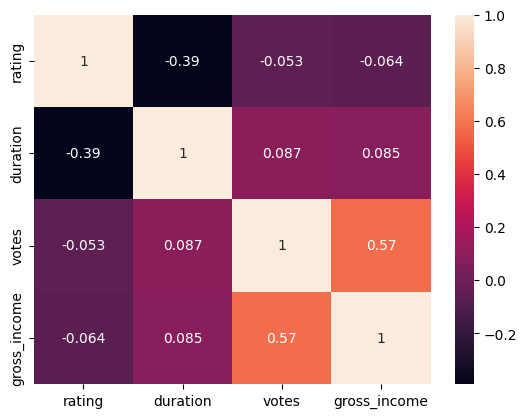

In [ ]:
sns.heatmap(movies_df.corr(), annot=True)

In [ ]:
#movies_df.dtypes[movies_df.dtypes != 'object']

# 1. Column Rating

In [ ]:
temp1 = movies_df.rating.unique()
temp2 = movies_df.rating.value_counts()
print(np.sort(temp1, axis=0))
print(temp2)

[ 1.   1.1  1.2  1.3  1.4  1.5  1.6  1.7  1.8  1.9  2.   2.1  2.2  2.3
  2.4  2.5  2.6  2.7  2.8  2.9  3.   3.1  3.2  3.3  3.4  3.5  3.6  3.7
  3.8  3.9  4.   4.1  4.2  4.3  4.4  4.5  4.6  4.7  4.8  4.9  5.   5.1
  5.2  5.3  5.4  5.5  5.6  5.7  5.8  5.9  6.   6.1  6.2  6.3  6.4  6.5
  6.6  6.7  6.8  6.9  7.   7.1  7.2  7.3  7.4  7.5  7.6  7.7  7.8  7.9
  8.   8.1  8.2  8.3  8.4  8.5  8.6  8.7  8.8  8.9  9.   9.1  9.2  9.3
  9.4  9.5  9.6  9.7  9.8  9.9 10.  11. ]
11.0    1960395
7.2       22946
7.6       22771
7.4       22730
7.8       22545
         ...   
1.2         194
1.4         173
1.5         141
1.1         132
1.3         126
Name: rating, Length: 92, dtype: int64


In [ ]:
(temp2.iloc[0]*100)/movies_df.shape[0]

75.66369939465798

* above we can observe that the rating for 75% of the instances is 11, which could be incorrect as IMDB ratings are usually out of 10.

In [ ]:
pe.histogram(x=movies_df.rating, title = "movie ratings", labels={'x':'movie ratings','y':'counts'})

* As more than 75% of the instances are having incorrect rating as 11, we will be plotting the graph for ratings except 11 to check the frequecy distribution more clearly

In [ ]:
pe.histogram(x=movies_df.rating[movies_df.rating <= 10],
             title = "movie ratings",
             labels={'x':'movie ratings','y':'frequency dist.'}
             )

# 2. Column - Duration

In [ ]:
temp1 = movies_df.duration.unique()
temp2 = movies_df.duration.value_counts()
print(f"min duration = {min(temp1)}, max duration = {max(temp1)}")
print(temp2)

min duration = 0, max duration = 13319
0       1608346
4         50271
30        44958
3         40341
60        38433
         ...   
712           1
404           1
399           1
2905          1
1773          1
Name: duration, Length: 711, dtype: int64


In [ ]:
(temp2.iloc[0]*100)/movies_df.shape[0]

62.07596339849907

* Above we observe that 62% of the instances have duration as 0 min, which is unusual. Any movies/series can't have duration as 0 min.
* This means duration is not present on IMDB for these instances

In [ ]:
#movies_df[movies_df.duration == 0].iloc[1608345]

pe.histogram(x=movies_df.duration,
             title = "movie ratings",
             labels={'x':'movie duration','y':'frequency dist.'}
             )

In [ ]:
pe.histogram(x =movies_df.duration,
             title = "movie ratings",
             labels={'x':'movie duration','y':'frequency dist.'},
             log_y=True, range_y = [1, 1000000], range_x = [0,1000]
             )

# 3. Column - Votes

In [ ]:
temp1 = movies_df.votes.unique()
temp2 = movies_df.votes.value_counts()
print(f"min votes = {min(temp1)}, max votes = {max(temp1)}")
print(temp2)

min votes = 0.0, max votes = 2574832.0
0.0        1960361
7.0          24660
8.0          23480
6.0          23109
9.0          20876
            ...   
22504.0          1
19489.0          1
13656.0          1
20060.0          1
5058.0           1
Name: votes, Length: 17503, dtype: int64


In [ ]:
(temp2.iloc[0]*100)/movies_df.shape[0]

75.66238712555945

* Above we observe that 75% of the instances have voting as 0 indicating these instances are unvoted yet.

In [ ]:
np.round(np.median(movies_df.votes))

0.0

In [ ]:
pe.histogram(x =movies_df.votes,
             title = "movie voting",
             labels={'x':'movie voting','y':'frequency dist.'},
             log_y=True, range_y = [1, 2000000], range_x = [0,100000]
             )

# 4. Column - Gross_Income

In [ ]:
temp1 = movies_df.gross_income.unique()
temp2 = movies_df.gross_income.value_counts()
print(f"min income = {min(temp1)}, max income = {max(temp1)}")
print(temp2)

min income = 0.0, max income = 936662225.0
0.00           2548877
1000000.00         125
0.01               113
3270000.00          69
4000000.00          63
                ...   
14182492.00          1
5711.00              1
38747385.00          1
25792310.00          1
492876.00            1
Name: gross_income, Length: 10653, dtype: int64


In [ ]:
pe.histogram(x = movies_df.gross_income[movies_df.gross_income != 0],
             title = "movie gross income",
             labels={'x':'movie gross income','y':'frequency dist.'}
             )

In [ ]:
filter1 = (movies_df.duration == 0)&(movies_df.rating >=10)&(movies_df.votes == 0)&(movies_df.gross_income == 0)
temp1 = movies_df[filter1]
print(temp1.shape)

(1448093, 14)


In [ ]:
temp1.shape[0]*100/movies_df.shape[0]

55.89081457946407

* we have around 55% of instances which do not have any data regarding duration(0), rating(11), votes(0) and gross income(0).
* These are one of the crucial factor for one to watch/recommend any movie.


## Removing these unnecessary instances

In [ ]:
movies_df.drop(index = temp1.index.tolist(), inplace = True)
print(movies_df.shape)
movies_df.reset_index(drop = True, inplace = True)
movies_df

(1142839, 14)


,id,name,year,rating,certificate,duration,genre,votes,gross_income,directors_id,directors_name,stars_id,stars_name,description
0,tt4710316,Best in Sex: 2015 AVN Awards,2015,4.0,TV-MA,94,"Adult, News",124.0,0.0,nm1624094,Gary Miller,"nm4766272,nm2670531,nm4920605,nm6284246","Farrah Laurel Abraham,Asa Akira,Anikka Albrite...",The hottest adult stars and top adult movies a...
1,tt1281857,Naughty Novelist,2008,3.8,Not Certified,88,Adult,174.0,0.0,nm0045256,John Bacchus,"nm0128986,nm1969196,nm0451160,nm6130462","Darian Caine,Jackie Stevens,A.J. Khan,Arrora",Darian is a successful journalist but when she...
2,tt2294954,2011 AVN Awards Show,2011,5.7,Not Certified,83,"Adult, News",39.0,0.0,"nm1624094,nm0754845","Gary Miller,Timothy E. Sabo","nm2200343,nm2670531,nm1267549,nm3585599","Aubrey Addams,Asa Akira,Monique Alexander,Rave...",N/A
3,tt6843596,Best in Sex: 2017 AVN Awards,2017,4.9,TV-MA,87,"Adult, News",225.0,0.0,nm1624094,Gary Miller,"nm5221471,nm2670531,nm4920605,nm3038816","Amirah Adara,Asa Akira,Anikka Albrite,Britney ...","Considered the industry's highest honor, the A..."
4,tt3705604,AVN Awards 2014,2014,6.7,R,82,"Adult, News",101.0,0.0,nm1624094,Gary Miller,"nm2670531,nm4920605,nm6284246,nm3992720","Asa Akira,Anikka Albrite,August Ames,Jessie An...",Erotic filmmaking superstars Chanel Preston an...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1142834,tt9893132,Chopped,2007–,8.7,TV-G,42,"Game-Show, Reality-TV",7.0,0.0,nm0669120,Michael Pearlman,"nm1388270,nm3129707,nm3713754,nm1948216","Ted Allen,Scott Conant,Amanda Freitag,Marcus S...","The chefs get some surprises in the baskets, s..."
1142835,tt9894346,Britain's Brightest Family,2018–,11.0,Not Certified,22,"Family, Game-Show",0.0,0.0,"/name/nm0235663/,/name/nm6712765/","Geraldine Dowd,Anne Hegerty",nm6712765,Anne Hegerty,Two families from Wales compete for a place in...
1142836,tt9894550,Impossible Celebrities,2018–,11.0,Not Certified,48,Game-Show,0.0,0.0,nm0726386,Richard van't Riet,"nm2051874,nm4587088,nm8877713,nm2928438","Rick Edwards,Jordan Banjo,Eyal Booker,Susan Ca...",Comedian Lucy Porter is the latest celebrity g...
1142837,tt9896728,The Price Is Right,1972–,11.0,TV-G,38,"Family, Game-Show, Reality-TV",0.0,0.0,Anonymous,N/A,"nm0004804,nm3012883,nm10550074,nm10550072","Drew Carey,Manuela Arbeláez,Spencer Chabot,Bri...","Games include '1/2 OFF', 'Squeeze Play' and 'S..."


In [ ]:
path = "/content/drive/MyDrive/Colab Notebooks/cleaned_imdb_movies_dataset.csv"
movies_df.to_csv(path, index = False)

In [ ]:
path

'/content/drive/MyDrive/Colab Notebooks/cleaned_imdb_movies_dataset.csv'

In [ ]:
movies_df = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/cleaned_imdb_movies_dataset.csv")
movies_df

,id,name,year,rating,certificate,duration,genre,votes,gross_income,directors_id,directors_name,stars_id,stars_name,description
0,tt4710316,Best in Sex: 2015 AVN Awards,2015,4.0,TV-MA,94,"Adult, News",124.0,0.0,nm1624094,Gary Miller,"nm4766272,nm2670531,nm4920605,nm6284246","Farrah Laurel Abraham,Asa Akira,Anikka Albrite...",The hottest adult stars and top adult movies a...
1,tt1281857,Naughty Novelist,2008,3.8,Not Certified,88,Adult,174.0,0.0,nm0045256,John Bacchus,"nm0128986,nm1969196,nm0451160,nm6130462","Darian Caine,Jackie Stevens,A.J. Khan,Arrora",Darian is a successful journalist but when she...
2,tt2294954,2011 AVN Awards Show,2011,5.7,Not Certified,83,"Adult, News",39.0,0.0,"nm1624094,nm0754845","Gary Miller,Timothy E. Sabo","nm2200343,nm2670531,nm1267549,nm3585599","Aubrey Addams,Asa Akira,Monique Alexander,Rave...",NaN
3,tt6843596,Best in Sex: 2017 AVN Awards,2017,4.9,TV-MA,87,"Adult, News",225.0,0.0,nm1624094,Gary Miller,"nm5221471,nm2670531,nm4920605,nm3038816","Amirah Adara,Asa Akira,Anikka Albrite,Britney ...","Considered the industry's highest honor, the A..."
4,tt3705604,AVN Awards 2014,2014,6.7,R,82,"Adult, News",101.0,0.0,nm1624094,Gary Miller,"nm2670531,nm4920605,nm6284246,nm3992720","Asa Akira,Anikka Albrite,August Ames,Jessie An...",Erotic filmmaking superstars Chanel Preston an...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1142834,tt9893132,Chopped,2007–,8.7,TV-G,42,"Game-Show, Reality-TV",7.0,0.0,nm0669120,Michael Pearlman,"nm1388270,nm3129707,nm3713754,nm1948216","Ted Allen,Scott Conant,Amanda Freitag,Marcus S...","The chefs get some surprises in the baskets, s..."
1142835,tt9894346,Britain's Brightest Family,2018–,11.0,Not Certified,22,"Family, Game-Show",0.0,0.0,"/name/nm0235663/,/name/nm6712765/","Geraldine Dowd,Anne Hegerty",nm6712765,Anne Hegerty,Two families from Wales compete for a place in...
1142836,tt9894550,Impossible Celebrities,2018–,11.0,Not Certified,48,Game-Show,0.0,0.0,nm0726386,Richard van't Riet,"nm2051874,nm4587088,nm8877713,nm2928438","Rick Edwards,Jordan Banjo,Eyal Booker,Susan Ca...",Comedian Lucy Porter is the latest celebrity g...
1142837,tt9896728,The Price Is Right,1972–,11.0,TV-G,38,"Family, Game-Show, Reality-TV",0.0,0.0,Anonymous,NaN,"nm0004804,nm3012883,nm10550074,nm10550072","Drew Carey,Manuela Arbeláez,Spencer Chabot,Bri...","Games include '1/2 OFF', 'Squeeze Play' and 'S..."


# Lets move ahead with multivariate analysis

In [ ]:
movies_df.columns

Index(['id', 'name', 'year', 'rating', 'certificate', 'duration', 'genre',
       'votes', 'gross_income', 'directors_id', 'directors_name', 'stars_id',
       'stars_name', 'description'],
      dtype='object')

# 1. Highest/Lowest Grossing movies in each Genre along with Gross Income

In [ ]:
# movies_df.loc[movies_df[movies_df.gross_income != 0].groupby(by='genre')['gross_income'].nlargest(2).index.get_level_values(1)].sort_values(by='duration', ascending=False)

temp = movies_df.loc[movies_df[movies_df.gross_income != 0].groupby(by='genre')['gross_income'].idxmax()]
temp.sort_values(by='gross_income', ascending=False, inplace=True)
temp1 = temp[['name','rating','genre','gross_income']].nlargest(15, columns='gross_income')
temp2 = temp[['name','rating','genre','gross_income']].nsmallest(15, columns='gross_income')
temp1

,name,rating,genre,gross_income
740565,Star Wars: Episode VII - The Force Awakens,7.8,"Action, Adventure, Sci-Fi",936662225.0
740496,Avengers: Endgame,8.4,"Action, Adventure, Drama",858373000.0
740484,Doctor Who,8.6,"Adventure, Drama, Sci-Fi",804747988.0
740483,Uncharted,6.4,"Action, Adventure",804747988.0
740482,The Lost City,6.2,"Action, Adventure, Comedy",804747988.0
740478,Spider-Man: No Way Home,8.3,"Action, Adventure, Fantasy",804747988.0
986160,Vikram,8.8,"Action, Thriller",804747988.0
941651,Outlander,8.4,"Drama, Fantasy, Romance",804747988.0
898444,Don't Look Up,7.2,"Comedy, Drama, Sci-Fi",760507625.0
740604,The Green Knight,6.6,"Adventure, Drama, Fantasy",700059566.0


In [ ]:
fig = pe.bar(x = temp1.genre, y=temp1.gross_income, color=temp1.name,
             title = "Top 15 highest grosser in their respective genres",
             labels = {'x':'Genre','y':'Gross Income'})
fig.show()

fig = pe.bar(x = temp2.genre, y=temp2.gross_income, color=temp2.name,
             title = "Top 15 lowest grosser in their respective genres",
             labels = {'x':'Genre','y':'Gross Income'})
fig.show()

# 2. Highest Grosser Overall

In [ ]:
movies_df[movies_df.id == 'tt0499549']

,id,name,year,rating,certificate,duration,genre,votes,gross_income,directors_id,directors_name,stars_id,stars_name,description
740518,tt0499549,Avatar,2009,7.8,PG-13,162,"Action, Adventure, Fantasy",1208822.0,760507625.0,nm0000116,James Cameron,"nm0941777,nm0757855,nm0000244,nm0735442","Sam Worthington,Zoe Saldana,Sigourney Weaver,M...",A paraplegic Marine dispatched to the moon Pan...


In [ ]:
temp1 = movies_df[movies_df.gross_income != 0][['name','rating','votes','gross_income','certificate','duration']].nlargest(15, columns='gross_income')
temp2 = movies_df[movies_df.gross_income != 0][['name','rating','votes','gross_income','certificate','duration']].nsmallest(15, columns='gross_income')

In [ ]:
fig = pe.bar(x = temp1.name, y=temp1.gross_income, color=temp1.rating,
             title = "Top 15 highest grosser overall with ratings",
             labels = {'x':'Name','y':'Gross Income','color':'Ratings/10'}
            )
fig.show()

fig = pe.bar(x = temp2.name, y=temp2.gross_income, color=temp2.rating,
             title = "Top 15 lowest grosser overall with ratings",
             labels = {'x':'Name','y':'Gross Income','color':'Ratings/10'}
            )
fig.show()

# 3. Genres that are profitable/loss-making to make a movie

In [17]:
#temp1 = movies_df[movies_df.gross_income != 0].groupby('genre')[['gross_income']].mean().sort_values('gross_income',ascending=False)

temp1 = movies_df[movies_df.gross_income != 0].groupby('genre')['gross_income'].mean().nlargest(10)
temp2 = movies_df[movies_df.gross_income != 0].groupby('genre')['gross_income'].mean().nsmallest(10)

In [30]:
# dir(pe.colors.sequential)
dir(pe.colors.qualitative)

['Alphabet',
 'Alphabet_r',
 'Antique',
 'Antique_r',
 'Bold',
 'Bold_r',
 'D3',
 'D3_r',
 'Dark2',
 'Dark24',
 'Dark24_r',
 'Dark2_r',
 'G10',
 'G10_r',
 'Light24',
 'Light24_r',
 'Pastel',
 'Pastel1',
 'Pastel1_r',
 'Pastel2',
 'Pastel2_r',
 'Pastel_r',
 'Plotly',
 'Plotly_r',
 'Prism',
 'Prism_r',
 'Safe',
 'Safe_r',
 'Set1',
 'Set1_r',
 'Set2',
 'Set2_r',
 'Set3',
 'Set3_r',
 'T10',
 'T10_r',
 'Vivid',
 'Vivid_r',
 '__all__',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__spec__',
 '_swatches',
 'swatches']

In [34]:
# px.pie(df, values='pop', names='country', title='Population of European continent')

fig = pe.bar(x = temp1.index, y=temp1,
             title = "Most profitable Genre on an average",
             labels = {'x':'Genre','y':'Average Income'},
             color_discrete_sequence = pe.colors.qualitative.Dark2
            )
fig.show()

fig = pe.bar(x = temp1.index, y=temp1,
             title = "Most Loss-Making Genres on an average",
             labels = {'x':'Genre','y':'Average Income'},
             color_discrete_sequence = pe.colors.qualitative.Bold
            )
fig.show()

In [35]:
movies_df.columns

Index(['id', 'name', 'year', 'rating', 'certificate', 'duration', 'genre',
       'votes', 'gross_income', 'directors_id', 'directors_name', 'stars_id',
       'stars_name', 'description'],
      dtype='object')

# Highest/Lowest grosser of each year

In [96]:
# np.sort(movies_df.year[(movies_df.year.isna() == False)&(movies_df.year.str.contains("–") == False)&(movies_df.year.str.contains("-") == False)].unique(), axis=0)

filter1 = (movies_df.year.isna() == False)&(movies_df.year.str.contains("–") == False)&(movies_df.year.str.contains("-") == False)&(movies_df.gross_income != 0)
temp = movies_df[filter1]

# movies_df.loc[movies_df[movies_df.gross_income != 0].groupby(by='genre')['gross_income'].idxmax()]


temp1 = temp.loc[temp.groupby('year')['gross_income'].idxmax()].sort_values(by='year')
temp2 = temp.loc[temp.groupby('year')['gross_income'].idxmin()].sort_values(by='year')
# temp1
# temp2

,id,name,year,rating,certificate,duration,genre,votes,gross_income,directors_id,directors_name,stars_id,stars_name,description
848063,tt0241715,Men Boxing,1891,4.7,Not Rated,1,"Documentary, Short, Action",979.0,0.01,"/name/nm0005690/,/name/nm0374658/","William K.L. Dickson,William Heise",Anonymous,NaN,Two men wearing boxing gloves prepare to spar ...
848019,tt0256782,Glenroy Brothers (Comic Boxing),1894,5.3,Not Rated,1,"Documentary, Short, Sport",801.0,47122.00,"/name/nm0005690/,/name/nm9389426/","William K.L. Dickson,The Glenroy Brothers",nm9389426,The Glenroy Brothers,The Glenroy Brothers perform a portion of thei...
128550,tt0000211,"The Astronomer's Dream; or, the Man in the Moon",1898,7.5,Not Rated,3,"Short, Comedy, Fantasy",4115.0,81200.00,nm0617588,Georges Méliès,"nm0194945,nm0617588","Jehanne d'Alcy,Georges Méliès",An astronomer falls asleep and has a strange d...
132400,tt0000370,Scrooge; or Marley's Ghost,1901,5.6,Not Certified,6,"Short, Drama, Fantasy",473.0,2013469.00,"/name/nm0095816/,/name/nm8709803/","Walter R. Booth,Daniel Smith",nm8709803,Daniel Smith,It's Christmas Eve. The miser Scrooge and his ...
943539,tt0229024,Gulliver's Travels,1902,6.6,Not Rated,4,"Short, Fantasy",866.0,11057.00,"/name/nm0617588/,/name/nm0617588/","Georges Méliès,Georges Méliès",nm0617588,Georges Méliès,"Gulliver washes ashore on Lilliput, the inhabi..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300109,tt8751900,Women Superstars Uncensored WSU Breaking Barri...,2018,11.0,Not Certified,155,"Action, Drama, Game-Show",0.0,0.01,nm3150343,David John Markland,"nm1696342,nm7023128,nm5992424,nm10058266","Jasmine Benitez,Tessa Blanchard,Jordynne Grace...",Women Superstars Uncensored presented their 'B...
849233,tt12273632,Mamy chempionov,2019,7.3,Not Certified,0,"Drama, Sport",17.0,0.01,Anonymous,NaN,"nm2611557,nm0747500,nm2705197,nm11558424","Ekaterina Vilkova,Irina Rozanova,Pavel Trubine...",NaN
510256,tt12065758,Diary of Our Days at the Breakwater,2020,7.1,Not Certified,23,"Animation, Comedy, Drama",135.0,0.01,Anonymous,NaN,"nm7657189,nm9532108,nm9492935,nm2574038","Kanon Takao,Natsumi Kawaida,Yû Sasahara,Satomi...",A young girl moves to a town by the ocean and ...
343759,tt16951886,The Adventure Mania,2021,11.0,Not Certified,134,"Animation, Adventure, Comedy",138.0,0.01,nm1844237,Chris Miller,"nm1868320,nm2081585,nm11763646,nm11763648","Ashleigh Ball,Jordan Ballard,Fly Discopal,Game...","So, Matthew Littlemore and the characters got ..."


In [94]:
fig = pe.bar(temp1, x = 'gross_income', y='year', color='name',
             width = 1000, height= 1700,
             title = "Highest Grosser Yearwise",
             labels = {'x':'Gross Income','y':'Year','color':'Movie/Series Name'})
fig.show()

In [97]:
fig = pe.bar(temp2, x = 'gross_income', y='year', color='name',
             width = 1000, height= 1700,
             title = "Lowest Grosser Yearwise",
             labels = {'x':'Gross Income','y':'Year','color':'Movie/Series Name'})
fig.show()